# Conversione da Dicom a NiNFTI

In questo codice si svolge la conversione dei file da **.dcm** a **.nii.gz**
Per farlo si è utilizzata la libreria dicom2ninfty.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
! pip install dicom2nifti
import dicom2nifti
import dicom2nifti.settings as settings
from pathlib import Path

# Conversione

Per convertire tutte le immagine in formato dcm che rappresentano l'immagine 3D finale si è utilizzata la funzione ***convert_directory***.



1.   Tramite il comando *mkdir* si crea la cartella che conterrà il file convertito.
2.  Il *try* *except* serve per far si che nel caso in cui una cartella esista già, quindi immagine già convertita, il codice non si blocchi per un Warring.
3. Tramite la funzione *rename* si rinomina il file all'interno della cartella creata con l'**id image**.

Sono necessari questi passaggi poichè convert_directory non permette di nominare il file come si vuole ma nomina direttamente il file con il nome dell'immagine. Con l'euristica seguente si è optato per salvare le immagini in base al loro **ID**.

In [4]:
directory = Path('/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_DCM')
for dicomImage in directory.iterdir():
  image_ID = str(dicomImage).split('/')[-1]
  percorso_completo = Path('/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_NiFTY') / image_ID

  try:
    percorso_completo.mkdir()

    settings.set_resample_spline_interpolation_order(1)
    settings.set_resample_padding(-1000)
    print(f"Conversione dell'immagine {image_ID}")
    dicom2nifti.convert_directory(f"/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_DCM/{image_ID}", f"/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_NiFTY/{image_ID}")

    for ninftyImage in percorso_completo.iterdir():
      new_name = image_ID + ".nii.gz"
      ninftyImage.rename(ninftyImage.with_name(new_name))

  except FileExistsError:
    print(f"La cartella {image_ID} esiste già")

La cartella I1221051 esiste già
La cartella I995496 esiste già
La cartella I1270068 esiste già
La cartella I1178908 esiste già
La cartella I1477561 esiste già
La cartella I1535666 esiste già
La cartella I1578905 esiste già
La cartella I1190913 esiste già
La cartella I1149746 esiste già
La cartella I1255144 esiste già
La cartella I1082571 esiste già
La cartella I1235535 esiste già
La cartella I1181460 esiste già
La cartella I1001975 esiste già
La cartella I1270084 esiste già
La cartella I1460759 esiste già
La cartella I1514449 esiste già
La cartella I1564163 esiste già
La cartella I1270004 esiste già
La cartella I1483624 esiste già
La cartella I1632972 esiste già
La cartella I1149858 esiste già
La cartella I1498987 esiste già
La cartella I1133565 esiste già
La cartella I1551506 esiste già
La cartella I1483603 esiste già
La cartella I1257925 esiste già
La cartella I1051710 esiste già
La cartella I1236721 esiste già
La cartella I1058014 esiste già
La cartella I1253392 esiste già
La cartel

In [11]:
DCM = Path("/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_DCM/")
NIN = Path("/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_NiFTY/")

# Usa il metodo glob() per trovare tutti i file nella cartella
DCM_lista = list(DCM.glob("*"))
NIN_lista = list(NIN.glob("*"))


print(f"Numero di file nella cartella DCM: {len(DCM_lista)}")
print(f"Numero di file nella cartella DCM: {len(NIN_lista)}")

Numero di file nella cartella DCM: 80
Numero di file nella cartella DCM: 80


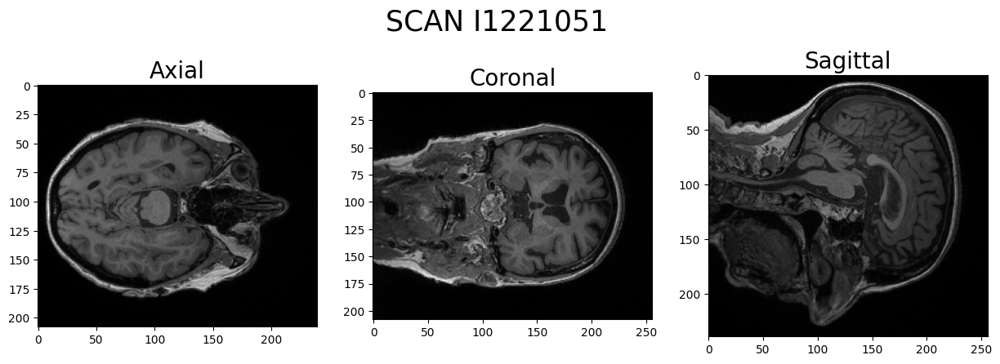

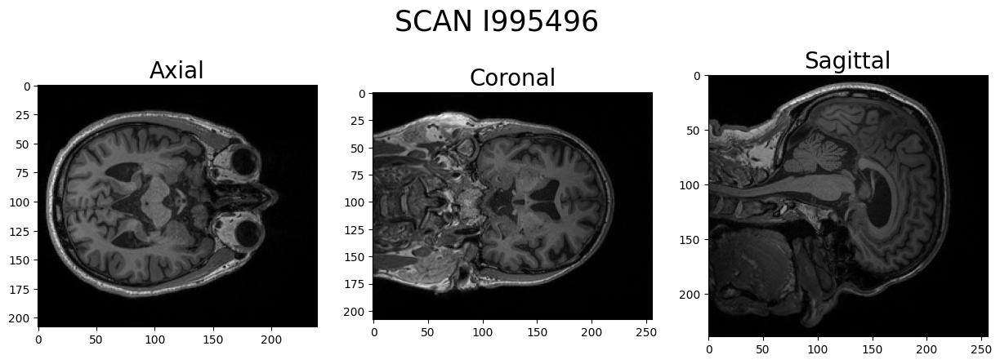

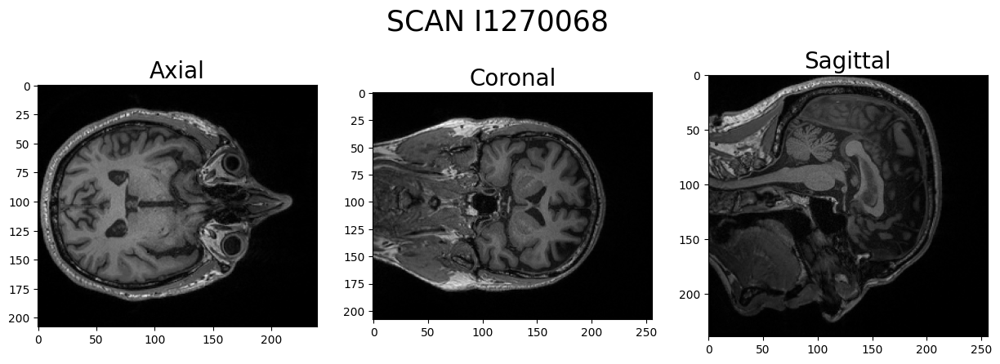

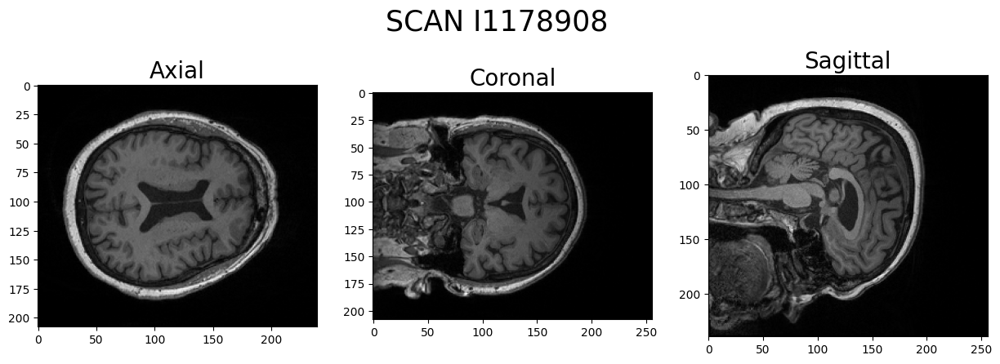

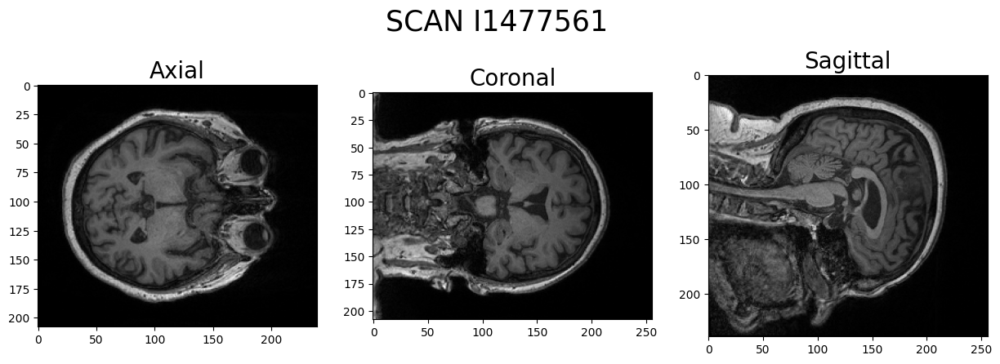

...

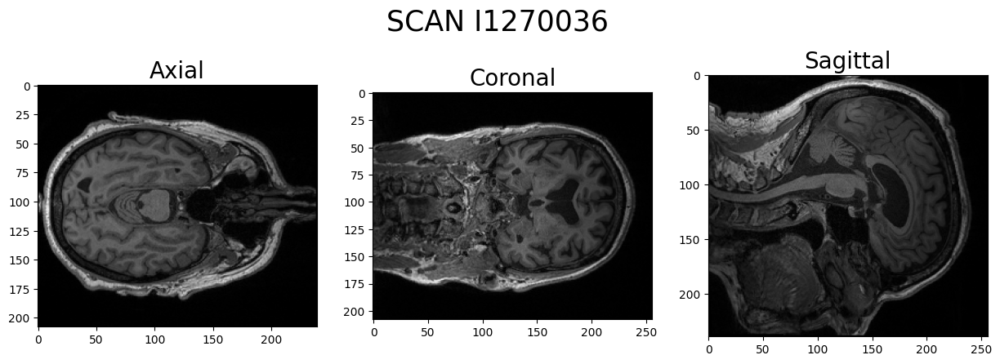

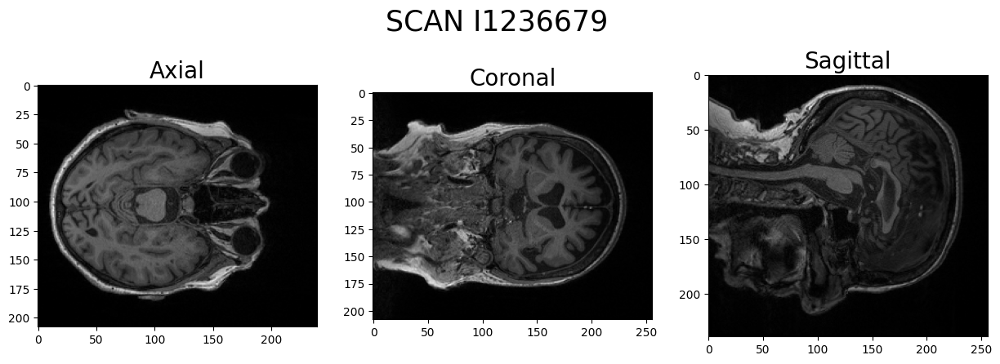

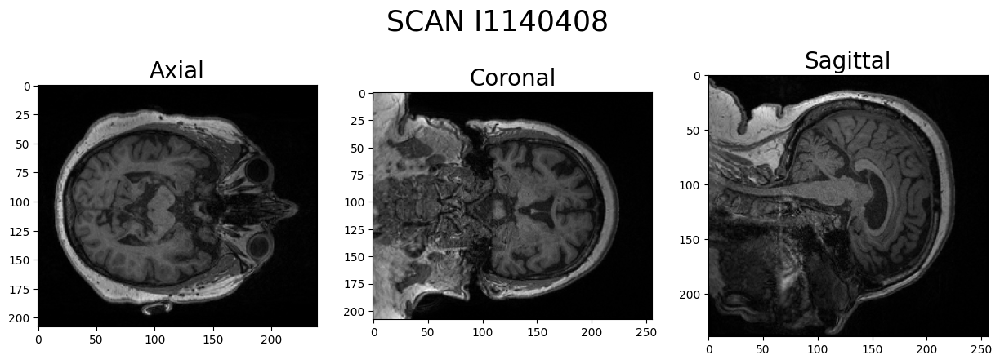

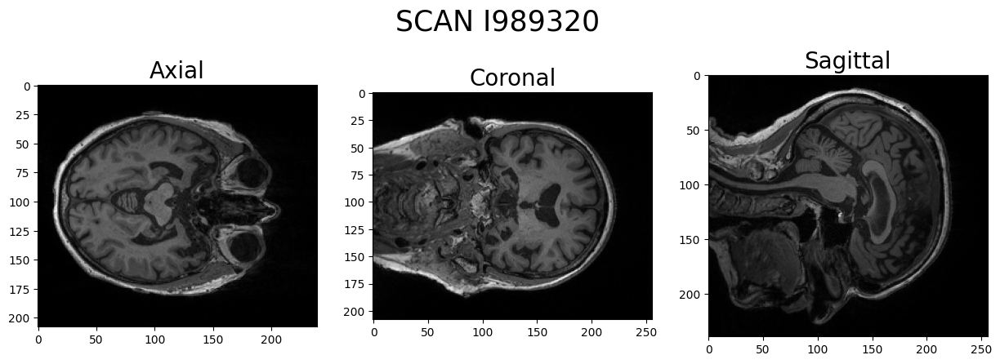

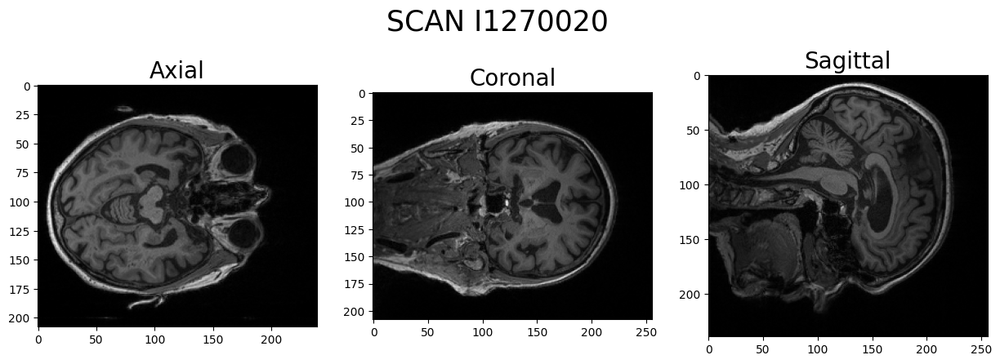

In [4]:
import nibabel as nib
import matplotlib.pyplot as plt

ninImage = Path('/content/drive/MyDrive/Colab_Notebooks/Tesi/Images/Image_NiFTY')
for dir in ninImage.iterdir():
  for image in dir.iterdir():
    nifti_path = str(image)
    nifti_image = nib.load(nifti_path)

    data = nifti_image.get_fdata()

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    plt.suptitle(f"SCAN {dir.name}", fontsize=25)

    axes[0].imshow(data[:, :, data.shape[2] // 2], cmap='gray')
    axes[0].set_title('Axial', fontsize=20)

    axes[1].imshow(data[:, data.shape[1] // 2, :], cmap='gray')
    axes[1].set_title('Coronal', fontsize=20)

    axes[2].imshow(data[data.shape[0] // 2, :, :], cmap='gray')
    axes[2].set_title('Sagittal', fontsize=20)

    plt.show()
